In [1]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import export_graphviz
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
import pandas as pd
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
import seaborn as sns
import matplotlib.pyplot as plt
import graphviz
%matplotlib inline

In [2]:
# 시각화 폰트 깨짐 방지
plt.rcParams['font.family'] = 'AppleGothic'

## 데이터 불러오기

In [3]:
mydata = pd.read_csv("data_main_weather.csv")

In [4]:
pd.set_option('mode.chained_assignment',  None)

In [5]:
for i in range(1,len(mydata)):
    if mydata['exposure'][i] == 0:
        mydata['exposure'][i] = mydata['exposure'][i-1]

In [6]:
mydata.to_csv('/Users/aohus/Documents/workspaces/Python/BigContest/src/data_main_weather1.csv', sep=',', na_rep='NaN')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/aohus/Documents/workspaces/Python/BigContest/src/data_main_weather1.csv'

In [7]:
# 이상치 처리1
filtering_outlier = mydata.query('revenue > 180000000')
filtering_outlier_index = list(filtering_outlier.index)

for i in filtering_outlier_index:
    tmp = mydata.loc[i,'mother_code']
    mydata.loc[i,'revenue'] = mydata[mydata['mother_code'] == tmp].sort_values(by='revenue' ,ascending=False)['revenue'].iloc[2]

In [ ]:
# 이상치 처리2

"""
filtering_outlier = mydata.query('revenue > 180000000')
filtering_outlier_index = list(filtering_outlier.index)

for i in filtering_outlier_index:
    mydata.loc[i,'revenue'] = mydata.loc[i-1,'revenue']
"""

In [8]:
mydata[mydata['revenue'] > 180000000]

,Unnamed: 0,datetime,year,month,date,dayofweek,time,hour,minute,holiday_1,...,revenue,sex,installment,code,repeat,holiday,m_temp,l_temp,h_temp,precipitation
35784,35784,2019-12-07 01:40:00,2019,12,7,5,01:40:00,1,40,1,...,187419000.0,무관,무관,201322,2,2019-12-07,0.1,-6.5,6.1,0.0
36267,36267,2019-12-11 00:00:00,2019,12,11,2,00:00:00,0,0,0,...,187419000.0,무관,무관,201322,3,2019-12-11,6.9,1.8,13.3,0.2
37356,37356,2019-12-21 17:40:00,2019,12,21,5,17:40:00,17,40,1,...,187419000.0,무관,무관,201322,2,2019-12-21,0.2,-4.1,4.7,0.1


In [9]:
idx_rev = mydata[mydata['revenue'] == 50000].index
tmp = mydata.drop(idx_rev)
tmp[tmp['revenue'] < 500000]['name']

129          푸마 INNO 심리스 롱드로즈 7종
407               푸마 NEW 트렁크 패키지
595            푸마 드라이셀라인 뉴 런닝 9종
678        푸마 INNO 심리스 롱드로즈 (1차)
2271         일시불 쿠첸 스마트 투인원 티메이커
                  ...           
37049             1세트 센티멘탈 디퓨저골드
37051             1세트 센티멘탈 디퓨저골드
37802    (무이자)엘렌실라&코즈미 쑥클렌져(단하루)
37880         까사마루 접이식 벤치 의자(2인)
37924               푸마 코튼 언더탑 9종
Name: name, Length: 66, dtype: object

In [10]:
tmp = pd.read_csv("data_main_weather.csv")
mainitem_list = []

for i in range(0,len(mydata)):
    if mydata['exposure'][i] != 0:
        mainitem_list.append(1)
    else:
        mainitem_list.append(0)
        
tmp = None
mydata['mainitem'] = mainitem_list
mainitem_list = None

In [11]:
tmp = pd.read_csv("data_main_weather1.csv")

--------

# *RandomForestRegressor*

## 1) RandomForest 성능 평가(MAPE)

In [12]:
# MAPE 평가 지표
import numpy as np

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

np.seterr(divide='ignore', invalid='ignore')

{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [699]:
#mydata1 = pd.read_csv("data_main_weather.csv")

In [13]:
mydata1 = mydata.dropna()
idx_rev = mydata1[mydata1['revenue'] == 50000].index
mydata1 = mydata1.drop(idx_rev)
mydata1 = mydata1.drop(['l_temp','h_temp','m_temp','precipitation', "mother_code","holiday_1","month",
                        'holiday','Unnamed: 0', 'code', 'datetime','name','time', 'year', 'count',
                       'minute','date'], axis=1)


#원핫 인코딩
categorical_feature_names = ["repeat", "category",'dayofweek',"mainitem"]

for var in categorical_feature_names:
    mydata1[var] = mydata1[var].astype("category")
    
mydata1 = pd.get_dummies(mydata1)

In [14]:
mydata1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 35379 entries, 0 to 38303
Data columns (total 37 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   hour             35379 non-null  int64  
 1   exposure         35379 non-null  float64
 2   price            35379 non-null  float64
 3   revenue          35379 non-null  float64
 4   dayofweek_0      35379 non-null  uint8  
 5   dayofweek_1      35379 non-null  uint8  
 6   dayofweek_2      35379 non-null  uint8  
 7   dayofweek_3      35379 non-null  uint8  
 8   dayofweek_4      35379 non-null  uint8  
 9   dayofweek_5      35379 non-null  uint8  
 10  dayofweek_6      35379 non-null  uint8  
 11  category_가구      35379 non-null  uint8  
 12  category_가전      35379 non-null  uint8  
 13  category_건강기능    35379 non-null  uint8  
 14  category_농수축     35379 non-null  uint8  
 15  category_생활용품    35379 non-null  uint8  
 16  category_속옷      35379 non-null  uint8  
 17  category_의류 

In [15]:
mydata1 = mydata1.drop(['category_의류', 'category_주방', 'category_가구',
                       'category_건강기능', 'category_가전', 'category_농수축', 'category_생활용품',
                       'category_속옷', 'category_이미용', 'category_잡화'], axis=1)

In [16]:
#column name 정렬
col_list = list(mydata1.columns.values)
col_list.remove('revenue')
col_list.append('revenue')
mydata1 = mydata1.reindex(columns = col_list)


# 트레이닝 테스트 셋
X = mydata1.iloc[:,:-1]
y = mydata1.iloc[:,-1]
y_log_transform = np.log1p(y)

X_train, X_test, y_train, y_test = train_test_split(X, y_log_transform, test_size=0.2, shuffle=True, random_state=100)

# 랜덤 포레스트 학습
rf = RandomForestRegressor(random_state=0, n_estimators=500, n_jobs=-1)
rf.fit(X_train,y_train)

# 예측
rf_pred = rf.predict(X_test)
rf_pred_e = np.expm1(rf_pred)
rf_pred_self = rf.predict(X_train)
rf_pred_self_e = np.expm1(rf_pred_self)

y_test = np.expm1(y_test)
y_train = np.expm1(y_train)
# MAPE, RMSE 점수
print("MAPE test score: " + str(mean_absolute_percentage_error(y_test , rf_pred_e)))
print("MAPE train score: " + str(mean_absolute_percentage_error(y_train , rf_pred_self_e)))
print("RMSE test score: " + str(mean_squared_error(y_test, rf_pred) ** 0.5))
print("RMSE train score: " + str(mean_squared_error(y_train, rf_pred_of) ** 0.5))
#print("MAE test score: " + str(mean_absolute_error(y_test, rf_pred)))
#print("MAE train score: " + str(mean_absolute_error(y_train, rf_pred_self)))

MAPE test score: 63.111545753452106
MAPE train score: 29.39579577504784
RMSE test score: 30334741.31444151


NameError: name 'rf_pred_of' is not defined

In [1762]:
mydata1 = mydata.dropna()
idx_rev = mydata1[mydata1['revenue'] == 50000].index
mydata1 = mydata1.drop(idx_rev)
mydata1 = mydata1.drop(['date','l_temp','h_temp','m_temp','precipitation', "mother_code","holiday_1",
                        'holiday','Unnamed: 0', 'code', 'datetime','name','time', 'year', 'count','month',
                       'minute'], axis=1)


#원핫 인코딩
categorical_feature_names = ["repeat", "category",'dayofweek',"mainitem"]

for var in categorical_feature_names:
    mydata1[var] = mydata1[var].astype("category")

mydata_notprime = mydata1[(mydata1['hour']>18) | (mydata1['hour']<15)]
mydata_prime = mydata1[(mydata1['hour']<=18) & (mydata1['hour']>=15)]

mydata_notprime = pd.get_dummies(mydata_notprime)
mydata_prime = pd.get_dummies(mydata_prime)
mydata_prime['category_가구'] = 0

#column name 정렬
col_list = list(mydata_prime.columns.values)
col_list.remove('revenue')
col_list.append('revenue')
mydata_notprime = mydata_notprime.reindex(columns = col_list)
mydata_prime = mydata_prime.reindex(columns = col_list)


# 트레이닝 테스트 셋
X_notprime = mydata_notprime.iloc[:,:-1]
y_notprime = mydata_notprime.iloc[:,-1]
y_notprime_log = np.log1p(y_notprime)

X_prime = mydata_prime.iloc[:,:-1]
y_prime = mydata_prime.iloc[:,-1]
y_prime_log = np.log1p(y_prime)

X_notprime_train, X_notprime_test, y_notprime_train, y_notprime_test = train_test_split(X_notprime, y_notprime_log, test_size=0.2, shuffle=True,random_state=100)
X_prime_train, X_prime_test, y_prime_train, y_prime_test = train_test_split(X_prime, y_prime_log, test_size=0.2, shuffle=True,random_state=100)

y_notprime_test = np.expm1(y_notprime_test)
y_prime_test = np.expm1(y_prime_test)

# 랜덤 포레스트 학습
rf_notprime = RandomForestRegressor(random_state=0, n_estimators=500, n_jobs=-1)
rf_notprime.fit(X_notprime_train,y_notprime_train)
rf_prime = RandomForestRegressor(random_state=0, n_estimators=500, n_jobs=-1)
rf_prime.fit(X_prime_train,y_prime_train)

# 예측
print("===============나누어 학습 / 나누어 예측한 MAPE================")
rf_notprime_pred = np.expm1(rf_notprime.predict(X_notprime_test))
rf_notprime_pred_self = np.expm1(rf_notprime.predict(X_notprime_train))
rf_prime_pred = np.expm1(rf_prime.predict(X_prime_test))
rf_prime_pred_self = np.expm1(rf_prime.predict(X_prime_train))

y_notprime_train = np.expm1(y_notprime_train)
y_prime_train = np.expm1(y_prime_train)

# MAPE, RMSE 점수
print("notprimetime MAPE test score: " + str(mean_absolute_percentage_error(y_notprime_test , rf_notprime_pred)))
print("primetime MAPE test score: " + str(mean_absolute_percentage_error(y_prime_test , rf_prime_pred)))

print("MAPE train score: " + str(mean_absolute_percentage_error(y_notprime_train , rf_notprime_pred_self)))
print("MAPE train score: " + str(mean_absolute_percentage_error(y_prime_train , rf_prime_pred_self)))

##########################이게 무슨 일인지 봐야함(나눴다합친 데이터셋 예측)#############################
print("===============나누었다 합쳐 예측한 MAPE================")
X_total_train = pd.concat([X_notprime_train, X_prime_train])
X_total_test = pd.concat([X_notprime_test, X_prime_test])

rf_total_pred = np.expm1(rf.predict(X_total_test))
rf_total_pred_self = np.expm1(rf.predict(X_total_train))

y_test1 = np.concatenate((y_notprime_test, y_prime_test), axis=None)
y_train1 = np.concatenate((y_notprime_train, y_prime_train), axis=None)

# MAPE, RMSE 점수
print("MAPE test score: " + str(mean_absolute_percentage_error(y_test1 , rf_total_pred)))
print("MAPE train score: " + str(mean_absolute_percentage_error(y_train1 , rf_total_pred_self)))

##########################이게 무슨 일인지 봐야함(전체 데이터셋 예측)#################################
print("===============전체 학습 / 전체 예측한 MAPE================")
# 예측
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state=100)

rf_pred = np.expm1(rf.predict(X_test))
rf_pred_self = np.expm1(rf.predict(X_train))

# MAPE, RMSE 점수
print("MAPE test score: " + str(mean_absolute_percentage_error(y_test , rf_pred)))
print("MAPE train score: " + str(mean_absolute_percentage_error(y_train , rf_pred_self)))

===============나누어 학습 / 나누어 예측한 MAPE================
primetime MAPE test score: 59.84666602055363
notprimetime MAPE test score: 45.9920686938894
MAPE train score: 25.49774807912077
MAPE train score: 25.607019018536946
===============나누었다 합쳐 예측한 MAPE================
MAPE test score: 30.978262143769424
MAPE train score: 31.330389023793952
===============전체 학습 / 전체 예측한 MAPE================
MAPE test score: 54.793247331013525
MAPE train score: 25.376419928227428


<AxesSubplot:>

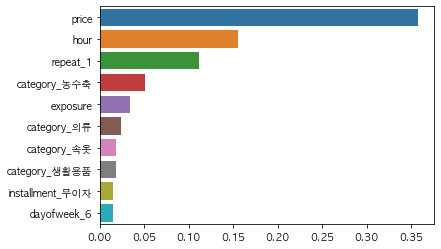

In [1735]:
feature_series = pd.Series(data=rf.feature_importances_, index=X_train.columns)
feature_series = feature_series.sort_values(ascending=False)[0:10]
sns.barplot(x=feature_series, y=feature_series.index)

## 랜덤포레스트로 6월 데이터 예측

### 6월 데이터 전처리

In [1666]:
data_predict = pd.read_csv("data_predict.csv")

In [1667]:
# 전처리 

# price 실수화
data_predict['price'] = data_predict['price'].str.replace(',','')
data_predict['price'] = data_predict['price'].str.replace('   ','')
data_predict['price'] = data_predict['price'].str.replace('    ','')
data_predict['price'] = data_predict['price'].str.replace('-', '0')
#data_predict.apply(pd.to_numeric, errors = 'coerce') 
data_predict['price'] = pd.to_numeric(data_predict['price'])

In [1668]:
# datetime 에서 hour, month, dayofweek 파생변수
data_predict['datetime'] = pd.to_datetime(data_predict['datetime'])
data_predict['month'] = data_predict['datetime'].dt.month
data_predict['dayofweek'] = data_predict['datetime'].dt.dayofweek
data_predict['hour'] = data_predict['datetime'].dt.hour

In [1669]:
# mainitem
data_predict['exposure'] = data_predict['exposure'].fillna(0)
mainitem = []

for i in range(0,len(data_predict)):
    if data_predict['exposure'][i] != 0:
        mainitem.append(1)
    else:
        mainitem.append(0)
        
data_predict['mainitem'] = mainitem
mainitem = None

In [1670]:
# repeat
repeat_list = [1]
a = 1

for i in range(1,len(data_predict)):
    if (data_predict['mother_code'][i] == data_predict['mother_code'][i-1]) & (data_predict['exposure'][i] != 0):
        a += 1
        repeat_list.append(a)
    elif (data_predict['mother_code'][i] == data_predict['mother_code'][i-1]) & (data_predict['exposure'][i] == 0):
        repeat_list.append(a)
    else:
        a = 1
        repeat_list.append(a)
        
data_predict['repeat'] = repeat_list

In [1671]:
# exposure nan -> time 채우기

for i in range(0,len(data_predict)):
    if data_predict['exposure'][i] == 0:
        data_predict['exposure'][i] = data_predict['exposure'][i-1]

In [1672]:
# sex(성별) 추가
sex = []

for i in range(len(data_predict)):
    if set(data_predict['name'][i].split()) & {"남성"} :
        sex.append("남성")
    elif set(data_predict['name'][i].split()) & {"여성"} :
        sex.append("여성")
    else :
        sex.append("무관")

data_predict['sex'] = sex

In [1673]:
# installment(할부) 추가
import re
installment = []

for i in range(len(data_predict)):
    if set(re.split('\[|\]|\(\)| ', data_predict['name'][i])) & {"무이자"} :
        installment.append("무이자")
    elif set(re.split('\[|\]|\(\)| ', data_predict['name'][i])) & {"일시불"} :
        installment.append("일시불")
    else :
        installment.append("무관")
        
data_predict['installment'] = installment

In [1674]:
idx_rev = data_predict[data_predict['price'] == 0].index
data_predict = data_predict.drop(idx_rev)

In [1694]:
data_predict.to_csv('/Users/aohus/Documents/workspaces/Python/BigContest/src/data_predict1.csv', sep=',', na_rep='NaN')

### 6월 데이터 모델에 넣어 예측

In [1753]:
data_predict1 = data_predict.drop(['revenue', 'code', 'datetime','name', 'month'], axis=1)

#원핫 인코딩
categorical_feature_names = ['repeat','category','dayofweek','mainitem']

for var in categorical_feature_names:
    data_predict1[var] = data_predict1[var].astype("category")

data_predict1 = pd.get_dummies(data_predict1)

In [1754]:
# 예측
data_predict_pred = np.expm1(rf.predict(data_predict1))

print(data_predict_pred)

[15906170.13379033 19087124.16663951 15881872.9691311  ...
 46340462.21536563 31768927.3341023  25057847.50409922]


In [1695]:
data_predict1['revenue'] = data_predict_pred

In [1696]:
data_predict1.to_csv('/Users/aohus/Documents/workspaces/Python/BigContest/src/data_predict_tmp.csv', sep=',', na_rep='NaN')

### searchCV 모델 튜닝 - 너무 오래걸려... 하지 말것

In [1150]:
from sklearn.model_selection import RandomizedSearchCV
from pprint import pprint

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 1000, num = 5)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 5)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
pprint(random_grid)

# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestRegressor()

# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -1)

# Fit the random search model
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed: 12.0min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed: 68.9min
[Parallel(n_jobs=-1)]: Done 300 out of 300 | elapsed: 150.1min finished


RandomizedSearchCV(cv=3, error_score=nan,
                   estimator=RandomForestRegressor(bootstrap=True,
                                                   ccp_alpha=0.0,
                                                   criterion='mse',
                                                   max_depth=None,
                                                   max_features='auto',
                                                   max_leaf_nodes=None,
                                                   max_samples=None,
                                                   min_impurity_decrease=0.0,
                                                   min_impurity_split=None,
                                                   min_samples_leaf=1,
                                                   min_samples_split=2,
                                                   min_weight_fraction_leaf=0.0,
                                                   n_estimators=100,
                              

In [1153]:
rf_random.best_estimator_

RandomForestRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='sqrt', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=2,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=287, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [1152]:
def evaluate(model, test_features, test_labels):
    predictions = model.predict(test_features)
    errors = abs(predictions - test_labels)
    mape = 100 * np.mean(errors / test_labels)
    accuracy = 100 - mape
    print('Model Performance')
    print('Average Error: {:0.4f} degrees.'.format(np.mean(errors)))
    print('Accuracy = {:0.2f}%.'.format(accuracy))
    
    return accuracy

base_model = RandomForestRegressor(n_estimators = 10, random_state = 42)
base_model.fit(X_train, y_train)
base_accuracy = evaluate(base_model, X_test, y_test)

best_random = rf_random.best_estimator_
random_accuracy = evaluate(best_random, X_test, y_test)

print('Improvement of {:0.2f}%.'.format( 100 * (random_accuracy - base_accuracy) / base_accuracy))

Model Performance
Average Error: 11079888.1405 degrees.
Accuracy = 30.43%.
Model Performance
Average Error: 10929512.4659 degrees.
Accuracy = 10.41%.
Improvement of -65.80%.


In [1143]:
print(np.array(y_test))
print(rf_pred.round(0))

[1.35510e+07 8.11000e+05 1.04840e+07 ... 1.04392e+08 1.37650e+07
 4.66080e+07]
[13692264.  6201550. 16686395. ... 26708077.  6023106. 14302055.]


In [828]:
"""
* 효과 뭐지? 찾아볼 것

categorical_feature_names = ["holiday_1", "repeat", "mother_code", "month", "date","dayofweek","hour","minute"]

for var in categorical_feature_names:
    mydata1[var] = mydata1[var].astype("category")
"""

'\n* 효과 뭐지? 찾아볼 것\n\ncategorical_feature_names = ["holiday_1", "repeat", "mother_code", "month", "date","dayofweek","hour","minute"]\n\nfor var in categorical_feature_names:\n    mydata1[var] = mydata1[var].astype("category")\n'

In [792]:
"""
X_test = mydata1[mydata1['month']==12].iloc[:,:-1]
X_train = mydata1[mydata1['month']!=12].iloc[:,:-1]
y_test = mydata1[mydata1['month']==12].iloc[:,-1]
y_train = mydata1[mydata1['month']!=12].iloc[:,-1]
"""

-----

### 튜닝2

In [1045]:
# 종합 확인

max_feature_list = [500, 600, 710]

for i in max_feature_list:
    rf = RandomForestRegressor(random_state=0, n_estimators=500, max_features=i, n_jobs=-1)
    rf.fit(X_train, y_train)
    rf_pred = rf.predict(X_test)
    rf_pred_of = rf.predict(X_train)
    MAPE_for_predictdata = mean_absolute_percentage_error(y_test, rf_pred)
    MAPE_for_traindata = mean_absolute_percentage_error(y_train, rf_pred_of)
    print ("MAPE(test) : " + str(MAPE_for_predictdata) + ", " + "MAPE(train) : " + str(MAPE_for_traindata))

MAPE(test) : 68.8088661847249, MAPE(train) : 47.08197065480318
MAPE(test) : 68.34379946207045, MAPE(train) : 47.054209869792174
MAPE(test) : 68.12365018889761, MAPE(train) : 47.09659212529153


In [841]:
# 종합 확인

max_depth_list=[10, 30, 35, 40, 45, 50]

for i in max_depth_list:
    rf = RandomForestRegressor(random_state=0, n_estimators=100, max_features=710, max_depth=i)
    rf.fit(X_train, y_train)
    rf_pred = rf.predict(X_test)
    rf_pred_of = rf.predict(X_train)
    MAPE_for_predictdata = mean_absolute_percentage_error(y_test, rf_pred)
    MAPE_for_traindata = mean_absolute_percentage_error(y_train, rf_pred_of)
    print ("MAPE(test) : " + str(MAPE_for_predictdata) + ", " + "MAPE(train) : " + str(MAPE_for_traindata))

MAPE(test) : 97.5094430837173, MAPE(train) : 37.94213579715955
MAPE(test) : 96.7098333097194, MAPE(train) : 32.03981419163445
MAPE(test) : 96.14188862431712, MAPE(train) : 29.025262428242797
MAPE(test) : 96.20550353968997, MAPE(train) : 27.71862948298043
MAPE(test) : 95.72576847430369, MAPE(train) : 27.15075936805091


In [1241]:
rf.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=500, n_jobs=-1, oob_score=False,
                      random_state=0, verbose=0, warm_start=False)

<AxesSubplot:>

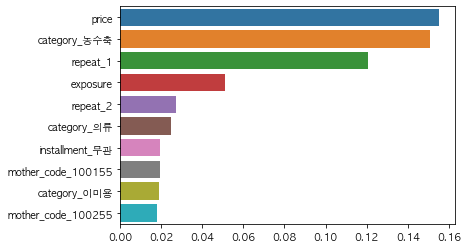

In [1242]:
feature_series = pd.Series(data=rf.feature_importances_, index=X_train.columns)
feature_series = feature_series.sort_values(ascending=False)[0:10]
sns.barplot(x=feature_series, y=feature_series.index)

## 2) Decision Tree

In [1243]:
dt_reg = DecisionTreeRegressor(max_depth=15).fit(X_train, y_train)

In [1244]:
dt_pred = dt_reg.predict(X_test)
dt_pred_train = dt_reg.predict(X_train)

In [1245]:
print(mean_absolute_percentage_error(y_test, dt_pred))
print(mean_absolute_percentage_error(y_train, dt_pred_train))

95.55711512763479
92.99610624397413


In [1040]:
ln_reg = LinearRegression().fit(X_train, y_train)
ln_pred = ln_reg.predict(X_test)
ln_pred_train = ln_reg.predict(X_train)

In [1041]:
print(mean_absolute_percentage_error(y_test, ln_pred))
print(mean_absolute_percentage_error(y_train, ln_pred_train))

100.15800406369515
80.49351212953385


### Decision Tree 시각화

In [1192]:
! brew install graphviz

Updating Homebrew...
==> Auto-updated Homebrew!
Updated 1 tap (homebrew/core).
==> New Formulae
cdktf                      mhonarc                    podman
clang-format@8             ormolu                     protoc-gen-gogofaster
localstack                 periscope                  sponge
==> Updated Formulae
Updated 2345 formulae.

==> Downloading https://homebrew.bintray.com/bottles/libpng-1.6.37.catalina.bott
==> Downloading from https://d29vzk4ow07wi7.cloudfront.net/c8e74da602c21f978cd7e
######################################################################## 100.0%
==> Downloading https://homebrew.bintray.com/bottles/freetype-2.10.2.catalina.bo
==> Downloading from https://d29vzk4ow07wi7.cloudfront.net/16500bbd77b8bbeb9a4ad
######################################################################## 100.0%
==> Downloading https://homebrew.bintray.com/bottles/fontconfig-2.13.1.catalina.
==> Downloading from https://d29vzk4ow07wi7.cloudfront.net/64ff208b28613dfe2a65b
###############

######################################################################## 100.0%
==> Downloading https://homebrew.bintray.com/bottles/pango-1.46.1.catalina.bottl
==> Downloading from https://d29vzk4ow07wi7.cloudfront.net/ddf6c6e74e58909336517
######################################################################## 100.0%
==> Downloading https://homebrew.bintray.com/bottles/graphviz-2.44.1.catalina.bo
==> Downloading from https://d29vzk4ow07wi7.cloudfront.net/e1cc69e09c92ac1507e46
######################################################################## 100.0%
==> Installing dependencies for graphviz: libpng, freetype, fontconfig, jpeg, libtiff, webp, gd, gettext, libffi, pcre, gdbm, openssl@1.1, readline, sqlite, xz, python@3.8, glib, jasper, netpbm, gts, libtool, lzo, pixman, cairo, fribidi, pkg-config, gobject-introspection, graphite2, icu4c, harfbuzz and pango
==> Installing graphviz dependency: libpng
==> Pouring libpng-1.6.37.catalina.bottle.tar.gz
🍺  /usr/local/Cellar/libpng/1.6.37

🍺  /usr/local/Cellar/python@3.8/3.8.5: 4,331 files, 67MB
==> Installing graphviz dependency: glib
==> Pouring glib-2.64.5.catalina.bottle.tar.gz
==> Caveats
Bash completion has been installed to:
  /usr/local/etc/bash_completion.d
==> Summary
🍺  /usr/local/Cellar/glib/2.64.5: 436 files, 14.8MB
==> Installing graphviz dependency: jasper
==> Pouring jasper-2.0.19.catalina.bottle.tar.gz
🍺  /usr/local/Cellar/jasper/2.0.19: 41 files, 1.3MB
==> Installing graphviz dependency: netpbm
==> Pouring netpbm-10.86.15.catalina.bottle.2.tar.gz
🍺  /usr/local/Cellar/netpbm/10.86.15: 410 files, 7.8MB
==> Installing graphviz dependency: gts
==> Pouring gts-0.7.6_2.catalina.bottle.tar.gz
🍺  /usr/local/Cellar/gts/0.7.6_2: 27 files, 1.1MB
==> Installing graphviz dependency: libtool
==> Pouring libtool-2.4.6_2.catalina.bottle.tar.gz
==> Caveats
In order to prevent conflicts with Apple's own libtool we have prepended a "g"
so, you have instead: glibtool and glibtoolize.
==> Summary
🍺  /usr/local/Cellar/libtoo

In [1193]:
import os
from tempfile import mkstemp
import subprocess
import graphviz
from subprocess import call
from IPython.display import Image

from sklearn.tree.export import export_graphviz

In [1246]:
def convert_decision_tree_to_ipython_image(dt_reg, feature_names=None, class_names=None,
                                           dot_filename=None, png_filename=None, tmp_dir=None):

    export_graphviz(dt_reg, out_file=dot_filename,
                    feature_names=feature_names,
                    filled=True, rounded=True,
                    special_characters=True)
        
    # Convert to png using system command (requires Graphviz)
    from subprocess import call
    call(['dot', '-Tpng', dot_filename, '-o', png_filename, '-Gdpi=1000'])

    # Display in jupyter notebook
    from IPython.display import Image
    Image(filename = png_filename)

In [1247]:
convert_decision_tree_to_ipython_image(dt_reg, dot_filename='revenue_depth15.dot', png_filename= 'revenue_depth15.png',feature_names=X_train.columns)

In [1223]:
export_graphviz(dt_reg, out_file='revenue1.dot',
                        feature_names=X_train.columns,
                        # class_names=class_names,
                        rounded = True, proportion = False, 
                        precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'revenue1.dot', '-o', 'revenue1.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'revenue1.png')

In [1323]:
tmp = X_train[(X_train["category_농수축"] == 1)
       & (X_train["repeat_1"] <= 0.5 )
#       & (X_train["mother_code_100492"] >= 0.5) 
       & (X_train["exposure"] <= 17.5)].index

mydata.loc[tmp][["datetime","name","repeat","exposure","price","revenue"]]

,datetime,name,repeat,exposure,price,revenue
29852,2019-10-08 17:10:00,고칼슘검은콩두유48팩+호두아몬드 두유48팩,2,10.0,30900.0,27003000.0
26300,2019-09-06 06:20:00,고칼슘검은콩두유48팩+호두아몬드 두유48팩,3,10.0,30900.0,13379000.0
28120,2019-09-22 18:30:00,국내산 손질 갑오징어 9팩,3,15.0,49900.0,35814000.0
29488,2019-10-05 11:15:00,국내산 손질 갑오징어 9팩,2,15.0,49900.0,34635000.0
35517,2019-12-04 13:50:00,고칼슘검은콩두유48팩+호두아몬드 두유48팩,4,10.0,30900.0,24732000.0
...,...,...,...,...,...,...
33039,2019-11-09 01:40:00,옛날 그 쥐포 110장 (11팩),2,17.0,32900.0,20659000.0
32843,2019-11-07 11:00:00,고칼슘검은콩두유48팩+호두아몬드 두유48팩,5,10.0,30900.0,30597000.0
37614,2019-12-24 12:00:00,완도산 식탁앤김 120봉,5,10.0,29900.0,12016000.0
34483,2019-11-24 01:40:00,국내산 영산포숙성 홍어 6팩+홍어무침1통,2,17.0,59900.0,14832000.0


In [1325]:
tmp = X_train[(X_train["category_농수축"] == 1)
       & (X_train["repeat_1"] <= 0.5 )
#       & (X_train["repeat_2"] >= 0.5 )
#       & (X_train["mother_code_100166"] <= 0.5)
#       & (X_train["mother_code_100492"] >= 0.5)
       & (X_train["exposure"] >= 17.5)].index

mydata.loc[tmp][["datetime","name","repeat","exposure","price","revenue"]]

,datetime,name,repeat,exposure,price,revenue
17141,2019-06-10 18:40:00,사용불가미리구운 자연산 바다장어 9팩,3,20.0,49900.0,31996000.0
3019,2019-02-02 16:20:00,국내산 손질갑오징어 8팩,2,20.0,49900.0,55070000.0
37328,2019-12-21 11:40:00,임성근의 녹용도가니탕 풀세트,2,20.0,55900.0,51399000.0
23937,2019-08-13 16:20:00,사용불가미리구운 자연산 바다장어 9팩,2,20.0,49900.0,41801000.0
2565,2019-01-28 15:20:00,천수봉명인 선재 전통 메주세트,2,20.0,96000.0,37414000.0
...,...,...,...,...,...,...
30588,2019-10-15 17:40:00,안동간고등어 20팩,3,20.0,30900.0,45499000.0
13311,2019-05-07 17:40:00,[맛있는 제주]손질 생선 3대세트(광어+갈치+고등어),3,20.0,49900.0,12078000.0
31016,2019-10-19 20:40:00,피시원 국내산 햇 손질문어 7팩,2,20.0,49900.0,63988000.0
21590,2019-07-22 18:40:00,멋진밥상 흥양농협 쌀 20kg,3,20.0,59900.0,35626000.0


In [1266]:
mydata[(mydata["category"]=="농수축") 
       & (mydata["repeat"] >= 2) 
       & (mydata["mother_code"] == 100166)
       & (mydata["exposure"] >= 17.5)][["datetime","name","price","exposure"]]

,datetime,name,price,exposure
11098,2019-04-18 17:20:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0
11099,2019-04-18 17:20:00,영광 生 모시떡 90개+찰보리식혜(동부기피70개+검정깨20개),30900.0,20.0
11100,2019-04-18 17:40:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0
11101,2019-04-18 17:40:00,영광 生 모시떡 90개+찰보리식혜(동부기피70개+검정깨20개),30900.0,20.0
11664,2019-04-23 18:20:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0
...,...,...,...,...
31299,2019-10-22 15:40:00,영광 生 모시떡 90개+찰보리식혜(동부기피70개+검정깨20개),30900.0,20.0
32055,2019-10-30 12:20:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0
32056,2019-10-30 12:40:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0
32560,2019-11-04 13:40:00,영광 生 모시떡 100개!!(동부기피70개+검정깨30개),30900.0,20.0


------------------

# *xgboostRegressor*

In [17]:
mydata = pd.read_csv("data_main_weather.csv")

In [18]:
pd.set_option('mode.chained_assignment',  None)

In [19]:
for i in range(1,len(mydata)):
    if mydata['exposure'][i] == 0:
        mydata['exposure'][i] = mydata['exposure'][i-1]

In [20]:
# 이상치 처리1
filtering_outlier = mydata.query('revenue > 180000000')
filtering_outlier_index = list(filtering_outlier.index)

for i in filtering_outlier_index:
    tmp = mydata.loc[i,'mother_code']
    mydata.loc[i,'revenue'] = mydata[mydata['mother_code'] == tmp].sort_values(by='revenue' ,ascending=False)['revenue'].iloc[2]

In [21]:
mydata[mydata['revenue'] > 180000000]

,Unnamed: 0,datetime,year,month,date,dayofweek,time,hour,minute,holiday_1,...,revenue,sex,installment,code,repeat,holiday,m_temp,l_temp,h_temp,precipitation
35784,35784,2019-12-07 01:40:00,2019,12,7,5,01:40:00,1,40,1,...,187419000.0,무관,무관,201322,2,2019-12-07,0.1,-6.5,6.1,0.0
36267,36267,2019-12-11 00:00:00,2019,12,11,2,00:00:00,0,0,0,...,187419000.0,무관,무관,201322,3,2019-12-11,6.9,1.8,13.3,0.2
37356,37356,2019-12-21 17:40:00,2019,12,21,5,17:40:00,17,40,1,...,187419000.0,무관,무관,201322,2,2019-12-21,0.2,-4.1,4.7,0.1


In [22]:
idx_rev = mydata[mydata['revenue'] == 50000].index
tmp = mydata.drop(idx_rev)
tmp[tmp['revenue'] < 500000]['name']

129          푸마 INNO 심리스 롱드로즈 7종
407               푸마 NEW 트렁크 패키지
595            푸마 드라이셀라인 뉴 런닝 9종
678        푸마 INNO 심리스 롱드로즈 (1차)
2271         일시불 쿠첸 스마트 투인원 티메이커
                  ...           
37049             1세트 센티멘탈 디퓨저골드
37051             1세트 센티멘탈 디퓨저골드
37802    (무이자)엘렌실라&코즈미 쑥클렌져(단하루)
37880         까사마루 접이식 벤치 의자(2인)
37924               푸마 코튼 언더탑 9종
Name: name, Length: 66, dtype: object

In [23]:
tmp = pd.read_csv("data_main_weather.csv")
mainitem_list = []

for i in range(0,len(mydata)):
    if mydata['exposure'][i] != 0:
        mainitem_list.append(1)
    else:
        mainitem_list.append(0)
        
tmp = None
mydata['mainitem'] = mainitem_list
mainitem_list = None

In [24]:
tmp = pd.read_csv("data_main_weather1.csv")

In [17]:
# 1~11월 데이터로 12월 매출예측

mydata1 = mydata.dropna()
idx_rev = mydata1[mydata1['revenue'] == 50000].index
mydata1 = mydata1.drop(idx_rev)
mydata1 = mydata1.drop(['l_temp','h_temp','m_temp','precipitation', "holiday_1",'Unnamed: 0', 'code',
                        'datetime','name','time', 'year', 'revenue', 'minute','date',"mainitem"], axis=1)


#원핫 인코딩
categorical_feature_names = ["category",'dayofweek','mother_code', 'subcategory','midcategory']

for var in categorical_feature_names:
    mydata1[var] = mydata1[var].astype("category")
    
mydata1 = pd.get_dummies(mydata1)


In [18]:
mydata1

,month,hour,exposure,price,repeat,count,mother_code_100000,mother_code_100001,mother_code_100002,mother_code_100006,...,subcategory_황태,subcategory_히비스커스,sex_남성,sex_무관,sex_여성,installment_남자,installment_무관,installment_무이자,installment_여자,installment_일시불
0,1,6,20.0,39900.0,1,52.606516,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
1,1,6,20.0,39900.0,1,109.548872,0,0,0,0,...,0,0,0,0,1,0,1,0,0,0
2,1,6,20.0,39900.0,2,81.754386,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
3,1,6,20.0,39900.0,2,174.310777,0,0,0,0,...,0,0,0,0,1,0,1,0,0,0
4,1,6,20.0,39900.0,3,167.218045,0,0,0,0,...,0,0,1,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38299,12,23,20.0,148000.0,2,68.628378,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
38300,1,0,20.0,178000.0,3,286.117978,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
38301,1,0,20.0,168000.0,3,621.380952,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
38302,1,0,20.0,158000.0,3,87.120253,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0


In [28]:
mydata1 = mydata1.drop(['category_의류', 'category_주방', 'category_가구',
                       'category_건강기능', 'category_가전', 'category_농수축', 'category_생활용품',
                       'category_속옷', 'category_이미용', 'category_잡화'], axis=1)

In [29]:
#column name 정렬
col_list = list(mydata1.columns.values)
col_list.remove('count')
col_list.append('count')
mydata1 = mydata1.reindex(columns = col_list)

#X_train, X_test, y_train, y_test = train_test_split(X, y_log_transform, test_size=0.2, shuffle=True, random_state=100)

# train, test set 분류
X_test = mydata1[mydata1['month']==12].iloc[:,:-1].drop(['hour','month'],axis=1)
X_train = mydata1[mydata1['month']!=12].iloc[:,:-1].drop(['hour','month'],axis=1)
y_test = np.log1p(mydata1[mydata1['month']==12].iloc[:,-1])
y_train = np.log1p(mydata1[mydata1['month']!=12].iloc[:,-1])

In [30]:
# 최종 적용 모델
xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, 
                          gamma=0.1, colsample_bytree=0.4, subsample=0.8)
xgb_model.fit(X_train, y_train)
xgb_pred = np.expm1(xgb_model.predict(X_test))
xgb_pred_self = np.expm1(xgb_model.predict(X_train))

y_test_tmp = np.expm1(y_test)
y_train_tmp = np.expm1(y_train)

print("MAPE test: "+str(mean_absolute_percentage_error(y_test_tmp, xgb_pred)))
print("MAPE train: "+str(mean_absolute_percentage_error(y_train_tmp, xgb_pred_self)))

MAPE test: 62.97192532572209
MAPE train: 38.21835586455536


In [33]:
y_test_tmp

35148    393.503597
35152    540.676692
35153    526.842105
35154    609.624060
35155    158.887640
            ...    
38295     11.243243
38296     51.398876
38297     90.964286
38298     14.734177
38299     68.628378
Name: count, Length: 2898, dtype: float64

In [34]:
xgb_pred

array([383.35925 , 486.92035 , 458.38647 , ...,  97.311966,  31.381191,
        67.29147 ], dtype=float32)

In [2235]:
MAPE_list = []

max_depth_list = [7,9,11]

for max_depth in max_depth_list:
    xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=max_depth, seed=0, 
                             gamma=0.1, colsample_bytree=0.4, subsample=0.8)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'tree depth':max_depth_list, 'mape':MAPE_list})
xgb_mape_df

,tree depth,mape
0,7,62.747441
1,9,59.909201
2,11,59.024000


In [2186]:
MAPE_list = []

n_estimators_list = [100, 500, 1000, 5000]

for n_estimators in n_estimators_list:
    xgb_model = XGBRegressor(learning_rate=0.01,n_estimators=n_estimators, max_depth=10,seed=0)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'num of estimators':n_estimators_list, 'mape':MAPE_list})
xgb_mape_df

,tree depth,mape
0,100,99.578842
1,500,73.155379
2,1000,70.939450
3,5000,70.923470


In [2187]:
MAPE_list = []

learning_rate_list = [0.1, 0.05, 0.01]

for learning_rate in learning_rate_list:
    xgb_model = XGBRegressor(learning_rate=learning_rate,n_estimators=1000, max_depth=10,seed=0)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'learning rate':learning_rate_list, 'mape':MAPE_list})
xgb_mape_df

,learning rate,mape
0,0.10,74.476181
1,0.05,69.525689
2,0.01,70.939450


In [2191]:
MAPE_list = []

booster_list = ['gbtree', 'gblinear']

for booster in booster_list:
    xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, booster=booster, seed=0)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'booster':booster_list, 'mape':MAPE_list})
xgb_mape_df

[15:56:31] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:480: 
Parameters: { max_depth } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




,booster,mape
0,gbtree,69.525689
1,gblinear,107.918072


In [2193]:
MAPE_list = []

gamma_list = [0, 0.1, 0.5, 1, 5]

for gamma in gamma_list:
    xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, gamma=0.1)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'gamma':gamma_list, 'mape':MAPE_list})
xgb_mape_df

,gamma,mape
0,0.0,69.525689
1,0.1,68.683250
2,0.5,71.063487
3,1.0,71.388807
4,5.0,75.632171


In [2195]:
MAPE_list = []

colsample_bytree_list = [0.2, 0.4, 0.6, 0.8, 1]

for colsample_bytree in colsample_bytree_list:
    xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, 
                             gamma=0.1, colsample_bytree=colsample_bytree)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'colsample':colsample_bytree_list, 'mape':MAPE_list})
xgb_mape_df

,colsample,mape
0,0.2,68.117649
1,0.4,66.493472
2,0.6,69.498867
3,0.8,69.641152
4,1.0,68.683250


In [2196]:
MAPE_list = []

subsample_list = [0.2, 0.4, 0.6, 0.8, 1]

for subsample in subsample_list:
    xgb_model = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, 
                             gamma=0.1, colsample_bytree=0.4, subsample=subsample)
    xgb_pred = np.expm1(xgb_model.fit(X_train, y_train).predict(X_test))
    y_test_tmp = np.expm1(y_test)
    MAPE_list.append(mean_absolute_percentage_error(y_test_tmp, xgb_pred))

xgb_mape_df = pd.DataFrame({'subsample':subsample_list, 'mape':MAPE_list})
xgb_mape_df

,subsample,mape
0,0.2,67.924801
1,0.4,67.344458
2,0.6,66.778818
3,0.8,66.039987
4,1.0,66.493472


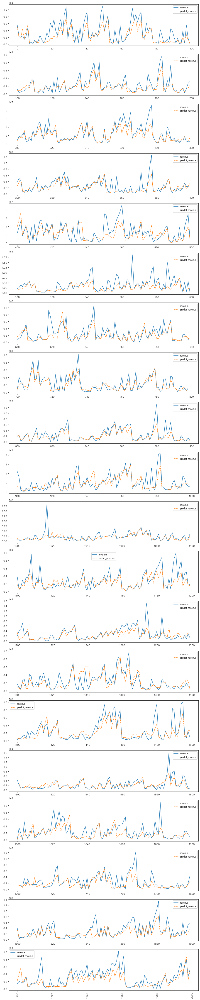

In [2209]:
# 1~11월 데이터로 12월 예측
predict12_df = y_test_tmp.to_frame()
predict12_df['predict_revenue'] = xgb_pred
predict12_df.reset_index(inplace=True)

mydata_tmp = mydata[['name','dayofweek','date','category','hour','price','datetime','repeat']]
mydata_tmp['index'] = mydata['Unnamed: 0']

december_tmp = pd.merge(predict12_df, mydata_tmp, left_on='index', right_on='index', how='inner')[['revenue','predict_revenue']]

fig, axes = plt.subplots(20,1,figsize=(15,80))

for i in range(0,2000,100):
    december_tmp_i = december_tmp[i:i+100]
    a = int(i/100)
    sns.lineplot(data = december_tmp_i, ax=axes[a])
    
plt.xticks(rotation=90)
plt.show()

In [2213]:
predict12_df['error'] = abs(predict12_df['revenue']-predict12_df['predict_revenue'])
bigerror12 = pd.merge(predict12_df, mydata_tmp, left_on='index', right_on='index', how='inner')[['index','datetime','dayofweek','category','name','repeat','revenue','predict_revenue','error']]
bigerror12_30 = bigerror12[bigerror12['error'] > 50000000]
bigerror12_30.sort_values(by='error', ascending = False)

,index,datetime,dayofweek,category,name,repeat,revenue,predict_revenue,error
566,35784,2019-12-07 01:40:00,5,의류,코몽트 덤블 플리스 자켓 2종,2,187419000.0,17237760.0,170181240.0
2029,37356,2019-12-21 17:40:00,5,의류,코몽트 덤블 플리스 자켓 2종,2,187419000.0,30503926.0,156915074.0
1017,36267,2019-12-11 00:00:00,2,의류,코몽트 덤블 플리스 자켓 2종,3,187419000.0,32756286.0,154662714.0
586,35804,2019-12-07 11:00:00,5,속옷,히트융 극세사 퍼융기모 남성 동내의 패키지,3,153084000.0,33459032.0,119624968.0
2696,38085,2019-12-29 16:00:00,6,주방,IH 옛 가마솥 세트,3,167261000.0,49762516.0,117498484.0
...,...,...,...,...,...,...,...,...,...
1275,36541,2019-12-13 22:00:00,4,가전,무이자 LG전자 매직스페이스 냉장고,3,96171000.0,44693956.0,51477044.0
2388,37748,2019-12-25 18:40:00,2,속옷,푸마 스트레치 심리스 드로즈 11종,2,57318000.0,5917697.5,51400302.5
66,35219,2019-12-01 19:40:00,6,이미용,비버리힐스폴로클럽 남성기초세트(골드+콜라겐),2,104111000.0,53240752.0,50870248.0
2368,37728,2019-12-25 13:40:00,2,속옷,레이프릴 오가닉 코튼 보정팬티 12종,2,80335000.0,29742510.0,50592490.0


In [2243]:
bigerror12[0:30]

,index,datetime,dayofweek,category,name,repeat,revenue,predict_revenue,error
0,35148,2019-12-01 00:00:00,6,속옷,오모떼 드레스핏 웜 쉐이퍼 패키지,3,54697000.0,49619780.00,5077220.00
1,35152,2019-12-01 01:20:00,6,속옷,오렐리안 히트모 스킨컬렉션 기모런닝 패키지,1,21573000.0,18039572.00,3533428.00
2,35153,2019-12-01 01:40:00,6,속옷,오렐리안 히트모 스킨컬렉션 기모런닝 패키지,2,21021000.0,19468594.00,1552406.00
3,35154,2019-12-01 02:00:00,6,속옷,오렐리안 히트모 스킨컬렉션 기모런닝 패키지,3,24324000.0,43774940.00,19450940.00
4,35155,2019-12-01 06:20:00,6,생활용품,바로바로 무선청소기+필터 1개 추가,1,14141000.0,16784770.00,2643770.00
5,35156,2019-12-01 06:40:00,6,생활용품,바로바로 무선청소기+필터 1개 추가,2,22666000.0,37144364.00,14478364.00
6,35157,2019-12-01 07:00:00,6,생활용품,바로바로 무선청소기+필터 1개 추가,3,46247000.0,54562400.00,8315400.00
7,35158,2019-12-01 07:20:00,6,가구,이조농방 보령황토 흙침대 퀸사이즈(TQ100),1,2091000.0,4220046.00,2129046.00
8,35159,2019-12-01 07:20:00,6,가구,이조농방 보령황토 흙카우치소파(TC100),1,6106000.0,4220046.00,1885954.00
9,35161,2019-12-01 07:20:00,6,가구,이조농방 보령황토 흙침대 싱글사이즈(TS100),1,1796000.0,2278830.75,482830.75


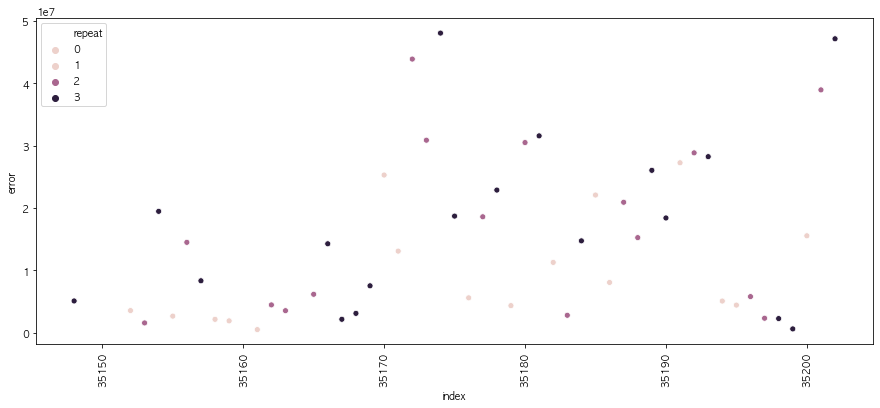

In [2240]:
plt.figure(figsize=(15,6))
sns.scatterplot(data = bigerror12[0:50], x='index', y='error', hue='repeat')
    
plt.xticks(rotation=90)
plt.show()

In [2208]:
bigerror12.describe()

,dayofweek,repeat,revenue,predict_revenue,error
count,2898.000000,2898.000000,2.898000e+03,2898.00,2.898000e+03
mean,2.893375,2.030366,2.741291e+07,21226168.00,1.046917e+07
std,2.107407,0.938077,2.453642e+07,15723956.00,1.382973e+07
min,0.000000,1.000000,1.790000e+05,415681.25,6.760000e+02
25%,1.000000,1.000000,8.698750e+06,8795120.00,2.390731e+06
50%,3.000000,2.000000,2.023500e+07,16735125.00,5.857418e+06
75%,5.000000,3.000000,3.910225e+07,29832889.50,1.287102e+07
max,6.000000,6.000000,1.874190e+08,89628672.00,1.701812e+08


In [2206]:
print(bigerror12_30['category'].value_counts())
print(bigerror12_30['dayofweek'].value_counts())
print(bigerror12_30['repeat'].value_counts())

가전      12
의류      12
주방       8
이미용      8
속옷       8
생활용품     7
농수축      6
잡화       2
가구       1
Name: category, dtype: int64
2    15
5    14
6    10
4     9
3     7
1     5
0     4
Name: dayofweek, dtype: int64
3    45
2    14
1     3
6     1
4     1
Name: repeat, dtype: int64


In [2207]:
print(bigerror12['category'].value_counts())
print(bigerror12['dayofweek'].value_counts())
print(bigerror12['repeat'].value_counts())

생활용품    544
주방      490
의류      330
농수축     327
잡화      282
속옷      281
이미용     213
가전      212
가구      141
건강기능     78
Name: category, dtype: int64
1    506
6    490
0    481
2    374
5    356
3    353
4    338
Name: dayofweek, dtype: int64
1    1014
2     922
3     881
4      41
5      21
6      19
Name: repeat, dtype: int64


In [2225]:
X_train

,exposure,price,repeat,dayofweek_0,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,dayofweek_6,...,category_이미용,category_잡화,category_주방,category_침구,sex_남성,sex_무관,sex_여성,installment_무관,installment_무이자,installment_일시불
0,20.0,39900.0,1,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
1,20.0,39900.0,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,0
2,20.0,39900.0,2,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
3,20.0,39900.0,2,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,0
4,20.0,39900.0,3,0,1,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35147,20.0,139000.0,2,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,1,0,0
38300,20.0,178000.0,3,0,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0
38301,20.0,168000.0,3,0,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0
38302,20.0,158000.0,3,0,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0


In [2233]:
X_test

,hour,exposure,price,repeat,dayofweek_0,dayofweek_1,dayofweek_2,dayofweek_3,dayofweek_4,dayofweek_5,...,category_이미용,category_잡화,category_주방,category_침구,sex_남성,sex_무관,sex_여성,installment_무관,installment_무이자,installment_일시불
35148,0,20.0,139000.0,3,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
35152,1,20.0,39900.0,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
35153,1,17.0,39900.0,2,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
35154,2,20.0,39900.0,3,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
35155,6,20.0,89000.0,1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38295,23,20.0,148000.0,1,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0
38296,23,20.0,178000.0,2,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0
38297,23,20.0,168000.0,2,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0
38298,23,20.0,158000.0,2,0,1,0,0,0,0,...,0,0,1,0,0,1,0,1,0,0


In [2322]:
# train, test set 분류
X_test = mydata1[mydata1['month']==12].iloc[:,:-1].drop(['month'],axis=1)
X_train = mydata1[mydata1['month']!=12].iloc[:,:-1].drop(['month'],axis=1)
y_test = np.log1p(mydata1[mydata1['month']==12].iloc[:,-1])
y_train = np.log1p(mydata1[mydata1['month']!=12].iloc[:,-1])

#mydata_notprime = mydata1[(mydata1['hour']>18) | (mydata1['hour']<15)]
#mydata_prime = mydata1[(mydata1['hour']<=18) & (mydata1['hour']>=15)]

# 프라임 시간대 X
X_notprime_train = X_train[(X_train['hour']>18) | (X_train['hour']<15)].drop(['hour'],axis=1)
X_notprime_test = X_test[(X_test['hour']>18) | (X_test['hour']<15)].drop(['hour'],axis=1)
ind_tmp1 = X_notprime_train.index
ind_tmp2 = X_notprime_test.index
y_notprime_train = y_train.loc[ind_tmp1]
y_notprime_test = y_test.loc[ind_tmp2]

# 프라임 시간대
X_prime_train = X_train[(X_train['hour']<=18) & (X_train['hour']>=15)].drop(['hour'],axis=1)
X_prime_test = X_test[(X_test['hour']<=18) & (X_test['hour']>=15)].drop(['hour'],axis=1)
ind_tmp1 = X_prime_train.index
ind_tmp2 = X_prime_test.index
y_prime_train = y_train.loc[ind_tmp1]
y_prime_test = y_test.loc[ind_tmp2]



# 랜덤 포레스트 학습
xgb_notprime = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, gamma=0.1, colsample_bytree=0.4, subsample=0.8)
xgb_notprime.fit(X_notprime_train,y_notprime_train)

xgb_prime = XGBRegressor(learning_rate=0.05,n_estimators=1000, max_depth=10, seed=0, gamma=0.1, colsample_bytree=0.4, subsample=0.8)
xgb_prime.fit(X_prime_train,y_prime_train)

# 예측
print("===============나누어 학습 / 나누어 예측한 MAPE================")
xgb_notprime_pred = np.expm1(xgb_notprime.predict(X_notprime_test))
xgb_prime_pred = np.expm1(xgb_prime.predict(X_prime_test))
#xgb_notprime_pred_self = np.expm1(xgb_reg_notprime.predict(X_notprime_train))
#xgb_prime_prime_pred_self = np.expm1(xgb_reg_prime.predict(X_prime_train))

#y_notprime_train = np.expm1(y_notprime_train)
#y_prime_train = np.expm1(y_prime_train)
y_notprime_test = np.expm1(y_notprime_test)
y_prime_test = np.expm1(y_prime_test)

# MAPE, RMSE 점수
print("MAPE test score: " + str(mean_absolute_percentage_error(xgb_notprime_pred , y_notprime_test)))
print("MAPE test score: " + str(mean_absolute_percentage_error(xgb_prime_pred , y_prime_test)))
#print("MAPE train score: " + str(mean_absolute_percentage_error(xgb_reg_notprime_pred_self , y_notprime_train)))
#print("MAPE train score: " + str(mean_absolute_percentage_error(xgb_reg_prime_prime_pred_self, y_prime_train)))

===============나누어 학습 / 나누어 예측한 MAPE================
MAPE test score: 61.81185054868046
MAPE test score: 53.17755887948429


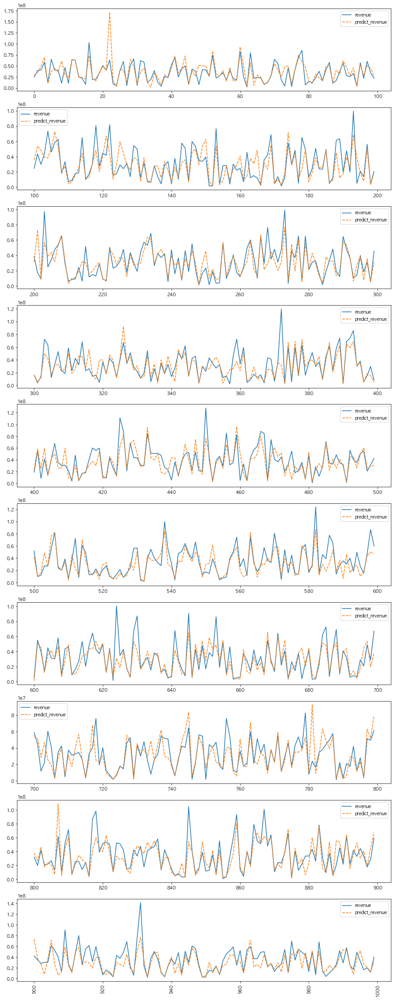

In [2110]:
# prediction df 생성
predictprime_df = y_prime_test.to_frame()
predictprime_df['predict_revenue'] = xgb_reg_prime_pred
predictprime_df.reset_index(inplace=True)

mydata_tmp = mydata[['name','dayofweek','date','category','hour','price','datetime','repeat']]
mydata_tmp['index'] = mydata['Unnamed: 0']

# merge로 information 추가
prime_tmp = pd.merge(predictprime_df, mydata_tmp, left_on='index', right_on='index', how='inner')[['revenue','predict_revenue']]

# predict 그래프 그리기
fig, axes = plt.subplots(10,1,figsize=(15,40))

for i in range(0,1000,100):
    prime_tmp_i = prime_tmp[i:i+100]
    a = int(i/100)
    sns.lineplot(data = prime_tmp_i, ax=axes[a])
    
plt.xticks(rotation=90)
plt.show()

In [2007]:
prime_tmp['error'] = abs(prime_tmp['revenue']-prime_tmp['predict_revenue'])
tmp = prime_tmp.reset_index()

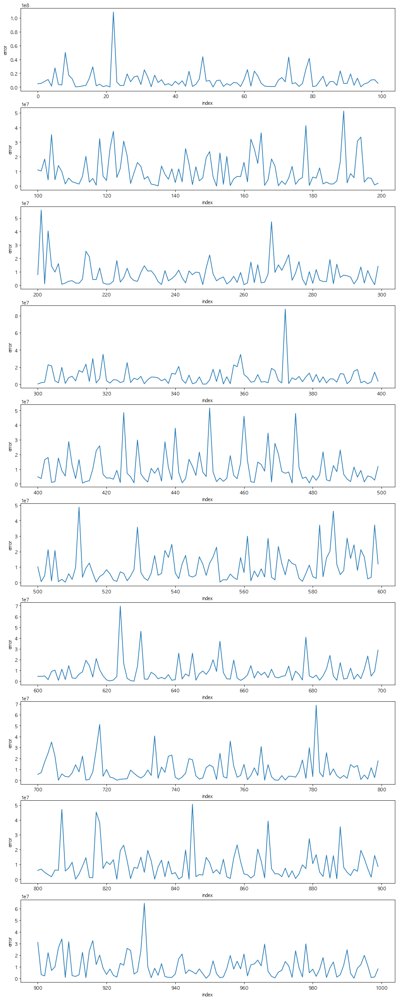

In [2014]:
fig, axes = plt.subplots(10,1,figsize=(15,40))

for i in range(0,1000,100):
    tmp_i = tmp[i:i+100]
    a = int(i/100)
    sns.lineplot(data = tmp_i, x='index', y='error', ax=axes[a])

In [2070]:
predictprime_df['error'] = abs(predictprime_df['revenue']-predictprime_df['predict_revenue'])
bigerror = pd.merge(predictprime_df, mydata_tmp, left_on='index', right_on='index', how='inner')[['datetime','dayofweek','category','name','repeat','revenue','predict_revenue','error']]
bigerror35 = bigerror[bigerror['error'] > 30000000]
bigerror35.sort_values(by='datetime')

,datetime,dayofweek,category,name,repeat,revenue,predict_revenue,error
653,2019-01-01 18:20:00,1,농수축,우리바다 손질왕꼬막 24팩,2,85937000.0,48918656.0,37018344.0
1051,2019-01-02 15:40:00,2,농수축,안동간고등어 20팩,3,70322000.0,36929892.0,33392108.0
79,2019-01-02 16:00:00,2,농수축,"SPC삼립 한입 호빵 13봉(단일, 팥 13봉)",1,6694000.0,48288740.0,41594740.0
165,2019-01-02 16:00:00,2,농수축,"SPC삼립 한입 호빵 13봉(혼합, 팥8+야채5봉)",1,11931000.0,48288740.0,36357740.0
845,2019-01-05 17:40:00,5,농수축,우리바다 손질왕꼬막 24팩,3,104552000.0,54017320.0,50534680.0
22,2019-01-13 17:40:00,6,이미용,비버리힐스폴로클럽 남성기초세트(2018FW골드),3,63223000.0,171677488.0,108454488.0
1002,2019-01-19 16:00:00,5,농수축,안동간고등어 20팩,1,46308000.0,8039500.0,38268500.0
193,2019-01-20 15:40:00,6,이미용,비버리힐스폴로클럽 남성기초세트(2018FW골드),3,99499000.0,68797800.0,30701200.0
125,2019-02-05 16:40:00,1,농수축,안동간고등어 20팩,3,29035000.0,59716272.0,30681272.0
704,2019-02-12 17:40:00,1,농수축,안동간고등어 20팩,3,60408000.0,25374404.0,35033596.0


In [2083]:
bigerror35['category'].value_counts()
# 농수축: 0.72
# 의류: 0.13
# 주방: 0.045

농수축     43
의류       7
이미용      3
주방       2
가전       1
생활용품     1
속옷       1
Name: category, dtype: int64

In [2055]:
bigerror['category'].value_counts()
# 농수축: 0.47
# 의류: 0.055
# 주방: 0.26

농수축     521
주방      287
의류       60
속옷       57
잡화       49
이미용      41
생활용품     37
가전       19
건강기능     13
침구       12
Name: category, dtype: int64

In [2072]:
bigerror35['dayofweek'].value_counts()

6    14
5    12
4     7
3     7
2     7
1     7
0     4
Name: dayofweek, dtype: int64

In [2073]:
bigerror['dayofweek'].value_counts()

6    180
4    178
1    162
2    160
0    157
3    141
5    118
Name: dayofweek, dtype: int64

In [2075]:
bigerror35['repeat'].value_counts()

3    32
2    16
1     9
4     1
Name: repeat, dtype: int64

In [2076]:
bigerror['repeat'].value_counts()

1    385
3    365
2    328
4     10
6      5
5      3
Name: repeat, dtype: int64

In [2081]:
bigerror[bigerror['category'] == '의류'].sort_values(by='datetime')

,datetime,dayofweek,category,name,repeat,revenue,predict_revenue,error
1047,2019-01-12 15:30:00,5,의류,로이몬스터 남녀 벤치후드롱패딩,2,56578000.0,8.495622e+07,2.837822e+07
669,2019-02-25 15:40:00,0,의류,더블유베일 캐시라이크 니트 4종,3,28353000.0,2.441597e+07,3.937032e+06
477,2019-03-10 15:20:00,6,의류,뱅뱅 여성 봄 데님팬츠 3종,2,22596000.0,1.895044e+07,3.645564e+06
509,2019-03-10 15:40:00,6,의류,뱅뱅 여성 봄 데님팬츠 3종,3,38659000.0,3.305195e+07,5.607054e+06
996,2019-03-12 17:00:00,1,의류,NNF SS트레이닝 세트,1,16290000.0,2.716244e+07,1.087244e+07
87,2019-03-16 15:00:00,5,의류,그렉노먼 남성 디보티 컬렉션 트렌치코트 1종,1,10432000.0,1.293289e+07,2.500888e+06
379,2019-03-17 15:00:00,6,의류,헤비추얼 남성 트렌치 맥코트,1,15869000.0,2.886468e+07,1.299568e+07
814,2019-03-19 16:00:00,1,의류,NNF SS트레이닝 세트,1,13848000.0,2.836199e+07,1.451399e+07
223,2019-03-19 16:20:00,1,의류,NNF SS트레이닝 세트,2,23279000.0,4.152615e+07,1.824715e+07
734,2019-03-24 15:00:00,6,의류,그렉노먼 남성 봄 컬렉션 티셔츠 5종,1,7935000.0,4.851696e+07,4.058196e+07


In [1985]:
predictnotprime_df = y_notprime_test.to_frame()
predictnotprime_df['predict_revenue'] = xgb_reg_notprime_pred
predictnotprime_df.reset_index(inplace = True)
tmp = predictprime_df.head(150)

In [1994]:
notprime_tmp = pd.merge(predictnotprime_df, mydata_tmp, left_on='index', right_on='index', how='inner')[['datetime','revenue','predict_revenue']]

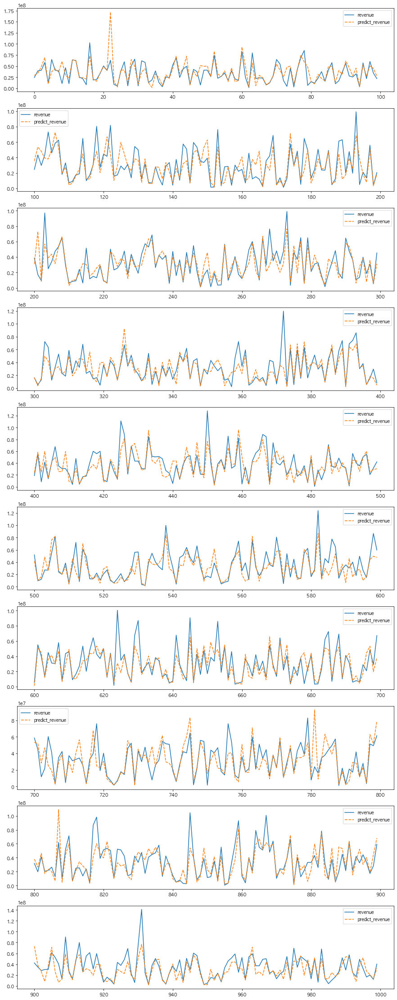

In [1996]:
fig, axes = plt.subplots(10,1,figsize=(15,40))

for i in range(0,1000,100):
    prime_tmp_i = prime_tmp[i:i+100]
    a = int(i/100)
    sns.lineplot(data = prime_tmp_i, ax=axes[a])
    
plt.show()

In [2034]:
predictnotprime_df['error'] = abs(predictnotprime_df['revenue']-predictnotprime_df['predict_revenue'])
bigerror_n = predictnotprime_df[predictnotprime_df['error'] > 35000000]
bigerror_info_n = pd.merge(bigerror_n, mydata_tmp, left_on='index', right_on='index', how='inner')[['datetime','dayofweek','category','name','revenue','predict_revenue','error']]
bigerror_info_n.sort_values(by='datetime')

,datetime,dayofweek,category,name,revenue,predict_revenue,error
46,2019-01-01 10:20:00,1,의류,CERINI by PAT 남성 풀패키지 기모니트 3종,97907000.0,51355664.0,46551336.0
23,2019-01-06 10:40:00,6,속옷,오모떼 레이스 파운데이션 브라,65610000.0,27796718.0,37813282.0
49,2019-01-07 22:40:00,0,속옷,로베르타 디 까메리노 올레이스 지퍼브라팬티,48373000.0,91546304.0,43173304.0
52,2019-02-13 22:40:00,2,이미용,비버리힐스폴로클럽 남성기초세트(2018FW골드),46777000.0,82926024.0,36149024.0
9,2019-02-16 23:40:00,5,생활용품,노비타 스마트 비데,53540000.0,93223784.0,39683784.0
...,...,...,...,...,...,...,...
21,2019-12-11 00:00:00,2,의류,코몽트 덤블 플리스 자켓 2종,187419000.0,31026400.0,156392600.0
5,2019-12-13 19:20:00,4,농수축,임성근의 녹용도가니탕 풀세트,44823000.0,9160739.0,35662261.0
2,2019-12-18 20:40:00,2,가전,LG전자 통돌이 세탁기 TR14WK1(화이트),57814000.0,100764152.0,42950152.0
25,2019-12-27 19:00:00,4,속옷,푸마 스트레치 심리스 드로즈 11종,51107000.0,10915227.0,40191773.0


# *시계열(Timeseries)*

In [2266]:
tsdata = mydata[['datetime','revenue']]

In [2267]:
tsdata.dropna(inplace=True)

In [2268]:
pd.to_datetime(tsdata['datetime'])

0       2019-01-01 06:00:00
1       2019-01-01 06:00:00
2       2019-01-01 06:20:00
3       2019-01-01 06:20:00
4       2019-01-01 06:40:00
                ...        
38299   2019-12-31 23:40:00
38300   2020-01-01 00:00:00
38301   2020-01-01 00:00:00
38302   2020-01-01 00:00:00
38303   2020-01-01 00:00:00
Name: datetime, Length: 37372, dtype: datetime64[ns]

In [2270]:
tsdata = pd.Series(list(tsdata['revenue']), index=tsdata['datetime'])

In [2271]:
tsdata

datetime
2019-01-01 06:00:00      2099000.0
2019-01-01 06:00:00      4371000.0
2019-01-01 06:20:00      3262000.0
2019-01-01 06:20:00      6955000.0
2019-01-01 06:40:00      6672000.0
                          ...     
2019-12-31 23:40:00     10157000.0
2020-01-01 00:00:00     50929000.0
2020-01-01 00:00:00    104392000.0
2020-01-01 00:00:00     13765000.0
2020-01-01 00:00:00     46608000.0
Length: 37372, dtype: float64

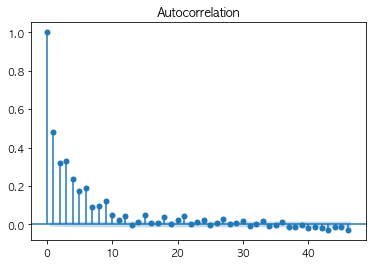

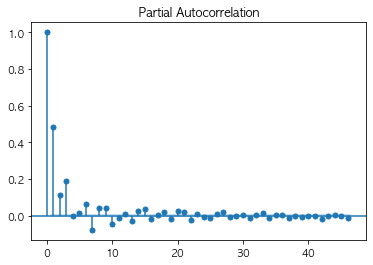

In [2283]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(tsdata)
plot_pacf(tsdata)
plt.show()

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:1192: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(xticklabels)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


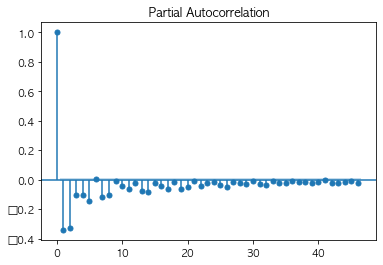

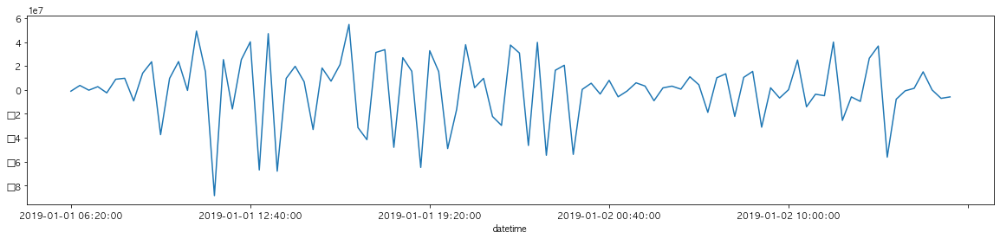

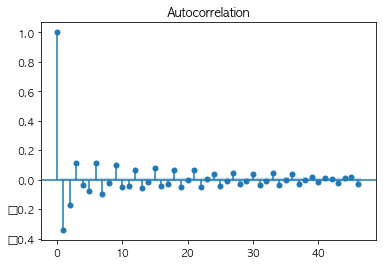

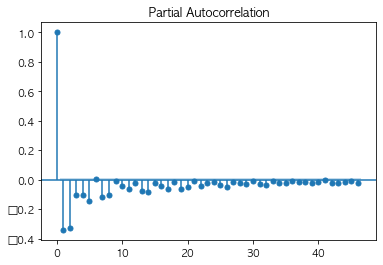

In [2287]:
tsdiff_1 = tsdata.diff(periods = 1).iloc[1:]
tsdiff_1[1:100].plot(figsize=(20,4))
plot_acf(tsdiff_1)
plot_pacf(tsdiff_1)

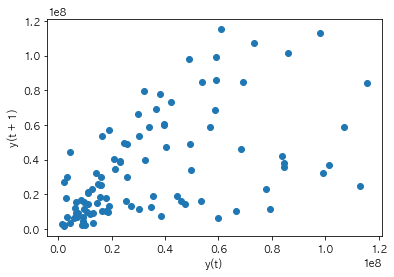

In [2294]:
from matplotlib import pyplot
from pandas.plotting import lag_plot
lag_plot(tsdata[1:100])
pyplot.show()

<AxesSubplot:xlabel='Lag', ylabel='Autocorrelation'>

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


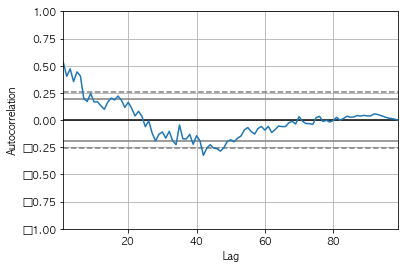

In [2293]:
from pandas.plotting import autocorrelation_plot
autocorrelation_plot(tsdata[1:100])

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


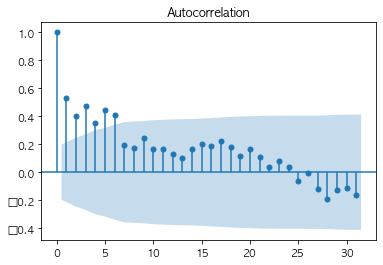

In [2297]:
from statsmodels.graphics.tsaplots import plot_acf
plot_acf(tsdata[1:100], lags=31)
pyplot.show()

Test MSE: 706853973650000.000


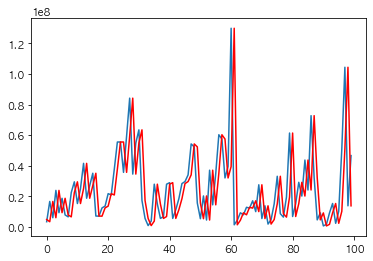

In [2300]:
from pandas import DataFrame
from pandas import concat
from matplotlib import pyplot
from sklearn.metrics import mean_squared_error

# create lagged dataset
values = DataFrame(tsdata.values)
dataframe = concat([values.shift(1), values], axis=1)
dataframe.columns = ['t-1', 't+1']

# split into train and test sets
X = dataframe.values
train, test = X[1:len(X)-100], X[len(X)-100:]
train_X, train_y = train[:,0], train[:,1]
test_X, test_y = test[:,0], test[:,1]
 
# persistence model
def model_persistence(x):
    return x
 
# walk-forward validation
predictions = list()
for x in test_X:
    yhat = model_persistence(x)
    predictions.append(yhat)
test_score = mean_squared_error(test_y, predictions)
print('Test MSE: %.3f' % test_score)

# plot predictions vs expected
pyplot.plot(test_y)
pyplot.plot(predictions, color='red')
pyplot.show()

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/statsmodels/tsa/ar_model.py:248: FutureWarning: The parameter names will change after 0.12 is released. Set old_names to False to use the new names now. Set old_names to True to use the old names. 
  warnings.warn(


Coefficients: [ 6.24600815e+06  4.15921149e-01  3.00266123e-02  1.60348251e-01
  1.45047394e-02 -2.03438173e-02  7.69257767e-02 -8.13167181e-02
  3.25531853e-02  5.17980228e-02 -2.97461036e-02 -2.27531650e-02
  5.74608402e-03 -3.44314999e-02  9.03530303e-03  3.69026299e-02
 -1.54577243e-02 -1.01430105e-02  2.09578217e-02 -2.30694709e-02
  1.65114456e-02  2.59639418e-02 -2.14805292e-02  1.04114338e-02
 -9.86601081e-03 -1.15923141e-02  1.16729948e-03  2.05226000e-02
 -2.17911173e-03 -4.89499959e-03  6.63968328e-03 -1.29199436e-02
 -1.05403768e-03  2.05753466e-02 -1.10854337e-02 -1.93198970e-03
  1.20204674e-02 -1.46600766e-02  1.49025721e-03 -3.80618564e-03
  3.78828029e-03  1.11994877e-03 -1.66852932e-02  1.01676088e-03
  4.48032597e-03  2.97285317e-03 -9.61986235e-03  4.76185655e-03
 -9.64638200e-03  4.32798670e-03 -6.89011145e-03  1.16341426e-02
 -6.05421233e-03  8.29695054e-03 -1.64733253e-03 -6.87681789e-03
  4.70888444e-03  8.90052894e-04 -6.81122434e-03  3.58260179e-03
 -1.0063537

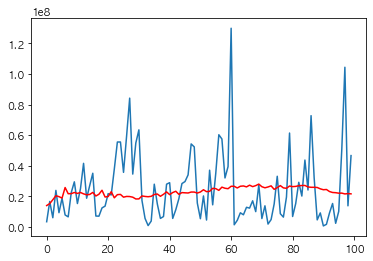

In [2312]:
from statsmodels.tsa.ar_model import AutoReg
from sklearn.metrics import mean_squared_error
from math import sqrt

# split dataset
X = tsdata.values
train, test = X[1:len(X)-100], X[len(X)-100:]

# train autoregression
model = AutoReg(train, lags=100)
model_fit = model.fit()
print('Coefficients: %s' % model_fit.params)

# make predictions
predictions = model_fit.predict(start=len(train), end=len(train)+len(test)-1, dynamic=False)
for i in range(len(predictions)):
    print('predicted=%f, expected=%f' % (predictions[i], test[i]))
rmse = sqrt(mean_squared_error(test, predictions))
MAPE = 
print('Test RMSE: %.3f' % rmse)

# plot results
pyplot.plot(test)
pyplot.plot(predictions, color='red')
pyplot.show()

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/statsmodels/tsa/ar_model.py:248: FutureWarning: The parameter names will change after 0.12 is released. Set old_names to False to use the new names now. Set old_names to True to use the old names. 
  warnings.warn(


predicted=23343562.406095, expected=5329000.000000
predicted=18393437.186926, expected=20228000.000000
predicted=18698924.263489, expected=4465000.000000
predicted=11983694.321500, expected=37062000.000000
predicted=26198087.149971, expected=14411000.000000
predicted=13822594.471853, expected=35005000.000000
predicted=29471738.141574, expected=60256000.000000
predicted=37826692.459663, expected=57461000.000000
predicted=35146230.966231, expected=31983000.000000
predicted=34102615.722654, expected=39434000.000000
predicted=32105484.748472, expected=129905000.000000
predicted=68561538.486956, expected=1357000.000000
predicted=20324004.953294, expected=4300000.000000
predicted=29140390.170220, expected=9205000.000000
predicted=12600827.978389, expected=7900000.000000
predicted=12221140.292743, expected=12803000.000000
predicted=22284015.656531, expected=12259000.000000
predicted=3806887.444350, expected=17044000.000000
predicted=21217287.157790, expected=9966000.000000
predicted=18803233.

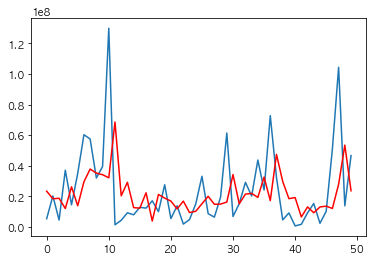

In [2318]:
# split dataset
X = tsdata.values
train, test = X[1:len(X)-50], X[len(X)-50:]

# train autoregression
window = 10
model = AutoReg(train, lags=100)
model_fit = model.fit()
coef = model_fit.params

# walk forward over time steps in test
history = train[len(train)-window:]
history = [history[i] for i in range(len(history))]
predictions = list()
for t in range(len(test)):
	length = len(history)
	lag = [history[i] for i in range(length-window,length)]
	yhat = coef[0]
	for d in range(window):
		yhat += coef[d+1] * lag[window-d-1]
	obs = test[t]
	predictions.append(yhat)
	history.append(obs)
	print('predicted=%f, expected=%f' % (yhat, obs))
rmse = sqrt(mean_squared_error(test, predictions))
print('Test RMSE: %.3f' % rmse)

# plot
pyplot.plot(test)
pyplot.plot(predictions, color='red')
pyplot.show()

In [2319]:
print("MAPE score: " + str(mean_absolute_percentage_error(predictions, test)))

MAPE score: 91.20363568845517


In [ ]:
# 단순이동평균

def make_sma_arr(window_num):
    ma_arr = np.array([])
    for i in df_month.store_id.unique():
        df_set = df_month[df_month.store_id == i]
        ma_arr = np.concatenate((ma_arr, df_set.amount.rolling(window=window_num).mean().values))
        
    return ma_arr